In [1]:
#importing required libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import nltk
from wordcloud import WordCloud

In [3]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Conv1D, MaxPool1D
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score

In [4]:
#importing fake news dataset and exploring it

In [5]:
fake=pd.read_csv('Fake.csv')

In [6]:
fake.head()

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"


In [7]:
fake.columns

Index(['title', 'text', 'subject', 'date'], dtype='object')

In [8]:
fake['subject'].value_counts()

subject
News               9050
politics           6841
left-news          4459
Government News    1570
US_News             783
Middle-east         778
Name: count, dtype: int64

In [9]:
#fake news dataset visualization (graph represents subject count)

<Axes: xlabel='subject', ylabel='count'>

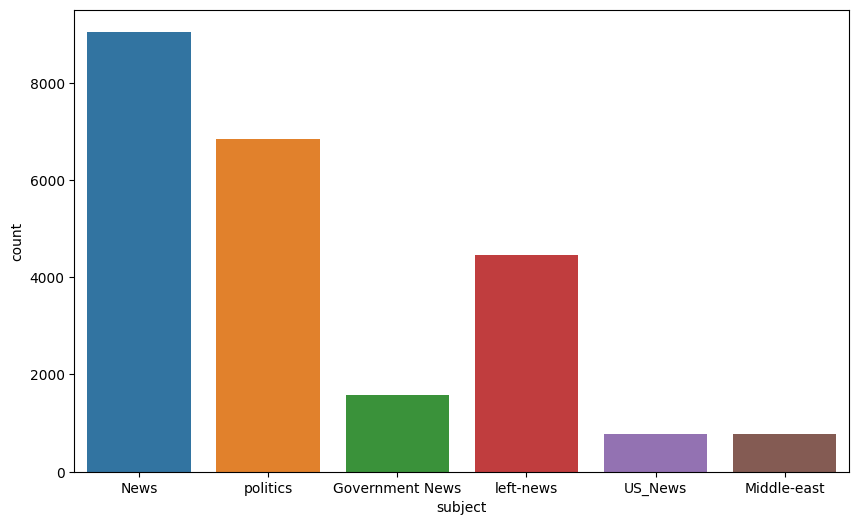

In [10]:
plt.figure(figsize=(10,6))
sns.countplot(x='subject',data=fake)

In [11]:
fake['text']

0        Donald Trump just couldn t wish all Americans ...
1        House Intelligence Committee Chairman Devin Nu...
2        On Friday, it was revealed that former Milwauk...
3        On Christmas day, Donald Trump announced that ...
4        Pope Francis used his annual Christmas Day mes...
                               ...                        
23476    21st Century Wire says As 21WIRE reported earl...
23477    21st Century Wire says It s a familiar theme. ...
23478    Patrick Henningsen  21st Century WireRemember ...
23479    21st Century Wire says Al Jazeera America will...
23480    21st Century Wire says As 21WIRE predicted in ...
Name: text, Length: 23481, dtype: object

In [12]:
fake['text'].tolist()

['Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that. Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.  The former reality show star had just one job to do and he couldn t do it. As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year,  President Angry Pants tweeted.  2018 will be a great year for America! As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year. 2018 will be a great year for America!  Donald J. Trump (@realDonaldTrump) December 31, 2017Trump s tweet went down about as welll as you d expect.What kind of president sends a New Year s greeting like this despicable, petty, infantile gibberish? Only Trump! His lack of decency won t e

In [13]:
text=' '.join(fake['text'].tolist())

In [14]:
#wordcloud for fake news

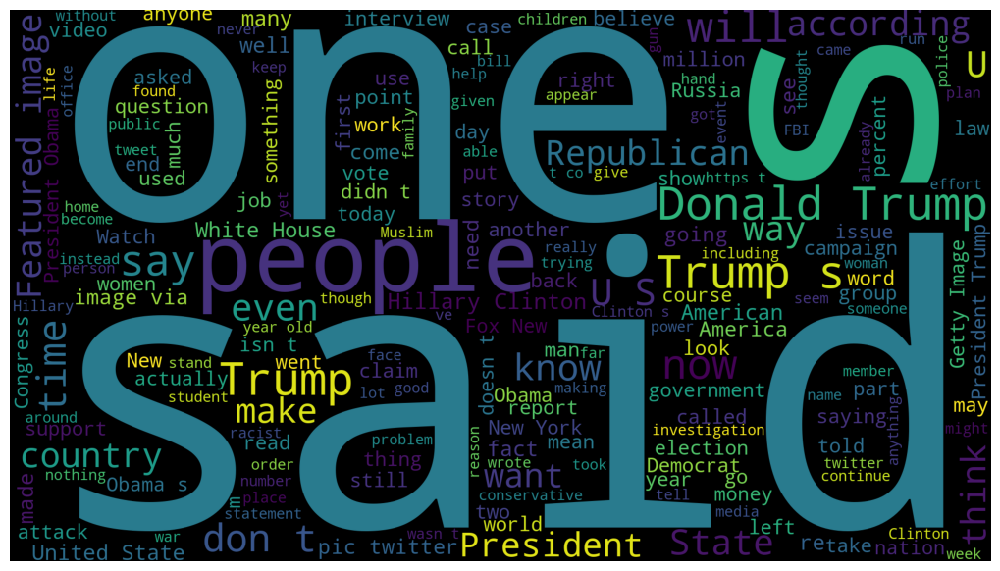

In [15]:
wordcloud=WordCloud(width=1920, height=1080).generate(text)
fig=plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [16]:
#importing real news

In [17]:
real=pd.read_csv('True.csv')

In [18]:
#exploring real news

In [19]:
real.head()


,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"


In [20]:
text=' '.join(real['text'].tolist())

In [21]:
#wordcloud for real news

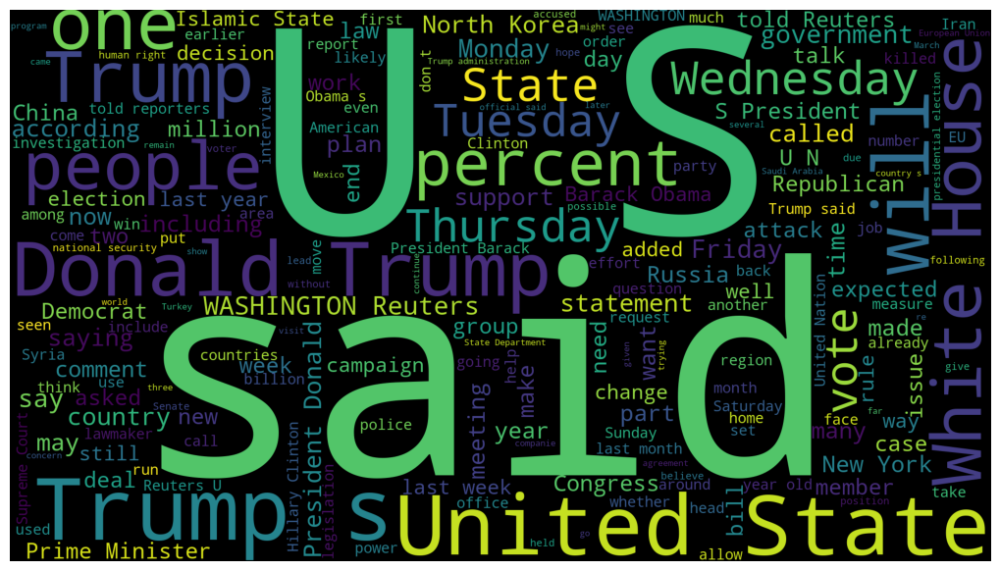

In [22]:
wordcloud=WordCloud(width=1920, height=1080).generate(text)
fig=plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [23]:
real.sample(5)

,title,text,subject,date
562,Any Trump NAFTA withdrawal faces stiff court c...,MEXICO CITY (Reuters) - With NAFTA talks grind...,politicsNews,"November 21, 2017"
13963,At least 54 killed after militants target mosq...,CAIRO (Reuters) - At least 54 people were kill...,worldnews,"November 24, 2017"
18019,NZ First leader says foreign ownership to be p...,WELLINGTON (Reuters) - The party holding the b...,worldnews,"October 8, 2017"
11121,Confident Trump says could 'shoot somebody' an...,"PELLA, Iowa /ANKENY, Iowa (Reuters) - U.S. Rep...",politicsNews,"January 23, 2016"
15678,Saudi detains four current ministers in anti-c...,"KHOBAR, Saudi Arabia (Reuters) - Saudi Arabia ...",worldnews,"November 4, 2017"


# Data Cleaning

Till now we imported libraries and dataset and started exploring it. Now we are going to clean the dataset 

In [24]:
#we are going to remove reuters i.e publishers information which is present in the real news dataset

Ingeneral the publishers information is at the starting of the text, reuters and text are seperated by a '-'.
So we are going to remove the ruters information on the basis of hyphon('-')
below we are iterating over text of real dataset using enumerate.
we are going to the each row and spliting the text based on '-' and also finding the text with no publishers

enumerate is used iterate over iterables,
assert is used to check the condition and raise the exceptions and iloc is used to perform indexing and slicing operation over data frame.

In [25]:
unknown_publishers=[]
for index,row in enumerate(real.text.values):
    try:
        record=row.split('-',maxsplit=1)
        record[1]
        assert(len(record[0])<120)
    except:
        unknown_publishers.append(index)

In [26]:
len(unknown_publishers)

222

In [27]:
real.iloc[unknown_publishers].text

7        The following statements were posted to the ve...
8        The following statements were posted to the ve...
12       The following statements were posted to the ve...
13       The following statements were posted to the ve...
14        (In Dec. 25 story, in second paragraph, corre...
                               ...                        
20135     (Story corrects to million from billion in pa...
20500     (This Sept 8 story corrects headline, clarifi...
20667     (Story refiles to add dropped word  not , in ...
21246     (Story corrects third paragraph to show Mosul...
21339     (Story corrects to fix spelling in paragraph ...
Name: text, Length: 222, dtype: object

In [28]:
# here we are remopving the 8970 index since it does not have any text

In [29]:
real.iloc[8970]

title      Graphic: Supreme Court roundup
text                                     
subject                      politicsNews
date                       June 16, 2016 
Name: 8970, dtype: object

In [30]:
real=real.drop(8970,axis=0)

In [31]:
# Now we are going to use enumerate and take all the publishers data into publishers list and all pure text into tmp_text

In [32]:
publisher=[]
tmp_text=[]
for index,row in enumerate(real.text.values):
    if index in unknown_publishers:
        tmp_text.append(row)
        publisher.append('Unknown')
    else:
        record=row.split('-',maxsplit=1)
        tmp_text.append(record[1].strip())
        publisher.append(record[0].strip())

Now we are creating the new column with publisher and replace text column with tmp_txt

In [33]:
real['publisher']=publisher
real['text']=tmp_text

In [34]:
 real.head()

,title,text,subject,date,publisher
0,"As U.S. budget fight looms, Republicans flip t...",The head of a conservative Republican faction ...,politicsNews,"December 31, 2017",WASHINGTON (Reuters)
1,U.S. military to accept transgender recruits o...,Transgender people will be allowed for the fir...,politicsNews,"December 29, 2017",WASHINGTON (Reuters)
2,Senior U.S. Republican senator: 'Let Mr. Muell...,The special counsel investigation of links bet...,politicsNews,"December 31, 2017",WASHINGTON (Reuters)
3,FBI Russia probe helped by Australian diplomat...,Trump campaign adviser George Papadopoulos tol...,politicsNews,"December 30, 2017",WASHINGTON (Reuters)
4,Trump wants Postal Service to charge 'much mor...,President Donald Trump called on the U.S. Post...,politicsNews,"December 29, 2017",SEATTLE/WASHINGTON (Reuters)


In [35]:
real.shape

(21416, 5)

In [36]:
#now we are checheking whether any text data in empty in fake dataset

In [37]:
empty_fake_index=[index for index,text in enumerate(fake.text.tolist()) if str(text).strip()==""]

In [38]:
fake.iloc[empty_fake_index]

,title,text,subject,date
10923,TAKE OUR POLL: Who Do You Think President Trum...,,politics,"May 10, 2017"
11041,Joe Scarborough BERATES Mika Brzezinski Over “...,,politics,"Apr 26, 2017"
11190,WATCH TUCKER CARLSON Scorch Sanctuary City May...,,politics,"Apr 6, 2017"
11225,MAYOR OF SANCTUARY CITY: Trump Trying To Make ...,,politics,"Apr 2, 2017"
11236,SHOCKER: Public School Turns Computer Lab Into...,,politics,"Apr 1, 2017"
...,...,...,...,...
21816,BALTIMORE BURNS: MARYLAND GOVERNOR BRINGS IN N...,,left-news,"Apr 27, 2015"
21826,FULL VIDEO: THE BLOCKBUSTER INVESTIGATION INTO...,,left-news,"Apr 25, 2015"
21827,(VIDEO) HILLARY CLINTON: RELIGIOUS BELIEFS MUS...,,left-news,"Apr 25, 2015"
21857,(VIDEO)ICE PROTECTING OBAMA: WON’T RELEASE NAM...,,left-news,"Apr 14, 2015"


In [39]:
 #here in the abouve we observed that both text and title data are present in title columnitself

In [40]:
#so now we are merging both text and title into the text column in both the datasets

In [41]:
real['text']=real['title']+real['text']
fake['text']=fake['title']+fake['text']

In [42]:
#now we are going to all the uppercase letters to lower case

In [43]:
real['text']=real['text'].apply(lambda x: str(x).lower())
fake['text']=fake['text'].apply(lambda x: str(x).lower())

# Preprocessing Data

In [44]:
#adding a column class with one real and zero for fake

In [45]:
real['class']=1 
fake['class']=0

In [46]:
#for the fake news detection we just need text colummn and class column so we are removing all other columns

In [47]:
real.columns

Index(['title', 'text', 'subject', 'date', 'publisher', 'class'], dtype='object')

In [48]:
fake.columns

Index(['title', 'text', 'subject', 'date', 'class'], dtype='object')

In [49]:
real=real[['text','class']]

In [50]:
real

,text,class
0,"as u.s. budget fight looms, republicans flip t...",1
1,u.s. military to accept transgender recruits o...,1
2,senior u.s. republican senator: 'let mr. muell...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge 'much mor...,1
...,...,...
21412,'fully committed' nato backs new u.s. approach...,1
21413,lexisnexis withdrew two products from chinese ...,1
21414,minsk cultural hub becomes haven from authorit...,1
21415,vatican upbeat on possibility of pope francis ...,1


In [51]:
fake=fake[['text','class']]

In [52]:
fake

,text,class
0,donald trump sends out embarrassing new year’...,0
1,drunk bragging trump staffer started russian ...,0
2,sheriff david clarke becomes an internet joke...,0
3,trump is so obsessed he even has obama’s name...,0
4,pope francis just called out donald trump dur...,0
...,...,...
23476,mcpain: john mccain furious that iran treated ...,0
23477,justice? yahoo settles e-mail privacy class-ac...,0
23478,sunnistan: us and allied ‘safe zone’ plan to t...,0
23479,how to blow $700 million: al jazeera america f...,0


In [53]:
data=pd.concat([real,fake]).reset_index(drop=True)

In [54]:
data

,text,class
0,"as u.s. budget fight looms, republicans flip t...",1
1,u.s. military to accept transgender recruits o...,1
2,senior u.s. republican senator: 'let mr. muell...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge 'much mor...,1
...,...,...
44892,mcpain: john mccain furious that iran treated ...,0
44893,justice? yahoo settles e-mail privacy class-ac...,0
44894,sunnistan: us and allied ‘safe zone’ plan to t...,0
44895,how to blow $700 million: al jazeera america f...,0


In [55]:
data.sample(5)

,text,class
30034,disgrace: ted cruz using anti-american propag...,0
13170,saudis pledge $100 million to african anti-jih...,1
37337,breaking news on clinton informant’s gag order...,0
12582,"russia's putin, egypt's sisi to sign nuclear p...",1
28996,karma strikes: white trump fanatic who sucker...,0


In [56]:
#removing all special characters and punctuations

In [57]:
 # Regular expression pattern to match non-alphanumeric characters and whitespace

In [58]:
def remove_special_characters(text):
    pattern = r'[^a-zA-Z0-9\s]' 
    clean_text = re.sub(pattern, '', text)
    return clean_text

In [59]:
data['text']=data['text'].apply(remove_special_characters)

In [60]:
data

,text,class
0,as us budget fight looms republicans flip thei...,1
1,us military to accept transgender recruits on ...,1
2,senior us republican senator let mr mueller do...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge much more...,1
...,...,...
44892,mcpain john mccain furious that iran treated u...,0
44893,justice yahoo settles email privacy classactio...,0
44894,sunnistan us and allied safe zone plan to take...,0
44895,how to blow 700 million al jazeera america fin...,0


In [61]:
data.sample(5)

,text,class
1041,highlights of reuters interview with house spe...,1
25454,hannity loses his sht after social media poun...,0
9424,democrats seeking unity give sanders say in pa...,1
801,trump says japan would shoot north korean miss...,1
16362,german coalition talks stumble on migration cl...,1


# Vectorization-Word2Vec

till now we have the data in the form of text. Now we have to convert this text data into numerical this terchnique is called vectorization. 
Vectorization refers to the process of converting textual data into a numerical representation that can be processed by machine learning algorithms. It involves representing text documents, sentences, or words as fixed-length numerical vectors. Vectorization techniques include methods like bag-of-words (BoW), term frequency-inverse document frequency (TF-IDF), and one-hot encoding. In vectorization, each word or token in the text is represented by a separate feature in the vector.

On the other hand, word embedding is a specific type of word representation that aims to capture the semantic and syntactic relationships between words. It maps words from a vocabulary to dense vector representations in a continuous vector space, where similar words are located closer to each other. Word embeddings are learned from large corpora of text using algorithms like Word2Vec, GloVe, or FastText. Unlike vectorization techniques that represent each word independently, word embeddings consider the context and distributional information of words in the text.

So, while vectorization is a broader term encompassing various methods to convert text into numerical vectors, word embedding is a specific technique within vectorization that creates dense vector representations of words based on their semantic relationships.

In [62]:
import gensim

In [63]:
y=data['class'].values

In [64]:
data['text'].tolist()

['as us budget fight looms republicans flip their fiscal scriptthe head of a conservative republican faction in the us congress who voted this month for a huge expansion of the national debt to pay for tax cuts called himself a fiscal conservative on sunday and urged budget restraint in 2018 in keeping with a sharp pivot under way among republicans us representative mark meadows speaking on cbs face the nation drew a hard line on federal spending which lawmakers are bracing to do battle over in january when they return from the holidays on wednesday lawmakers will begin trying to pass a federal budget in a fight likely to be linked to other issues such as immigration policy even as the november congressional election campaigns approach in which republicans will seek to keep control of congress president donald trump and his republicans want a big budget increase in military spending while democrats also want proportional increases for nondefense discretionary spending on programs that 

In [65]:
x=[d.split() for d in data['text'].tolist()]

In [66]:
x

[['as',
  'us',
  'budget',
  'fight',
  'looms',
  'republicans',
  'flip',
  'their',
  'fiscal',
  'scriptthe',
  'head',
  'of',
  'a',
  'conservative',
  'republican',
  'faction',
  'in',
  'the',
  'us',
  'congress',
  'who',
  'voted',
  'this',
  'month',
  'for',
  'a',
  'huge',
  'expansion',
  'of',
  'the',
  'national',
  'debt',
  'to',
  'pay',
  'for',
  'tax',
  'cuts',
  'called',
  'himself',
  'a',
  'fiscal',
  'conservative',
  'on',
  'sunday',
  'and',
  'urged',
  'budget',
  'restraint',
  'in',
  '2018',
  'in',
  'keeping',
  'with',
  'a',
  'sharp',
  'pivot',
  'under',
  'way',
  'among',
  'republicans',
  'us',
  'representative',
  'mark',
  'meadows',
  'speaking',
  'on',
  'cbs',
  'face',
  'the',
  'nation',
  'drew',
  'a',
  'hard',
  'line',
  'on',
  'federal',
  'spending',
  'which',
  'lawmakers',
  'are',
  'bracing',
  'to',
  'do',
  'battle',
  'over',
  'in',
  'january',
  'when',
  'they',
  'return',
  'from',
  'the',
  'holid

In [67]:
DIM=100
w2v_model=gensim.models.Word2Vec(sentences=x, vector_size=DIM, window=10, min_count=1)

In [68]:
len(w2v_model.wv.key_to_index)

251801

In [69]:
 w2v_model.wv['india']

array([-1.4771878e+00,  5.8101398e-01, -1.1075203e+00,  5.3917333e-02,
        2.9270294e+00, -8.6379886e-01, -1.2882564e+00, -3.3243412e-01,
       -7.8694773e-01,  3.6535656e+00, -1.5118771e+00, -2.9769864e+00,
       -5.5192000e-01, -2.2966700e+00,  2.4078777e+00,  6.3898444e-01,
       -2.9286625e+00,  7.4605101e-01, -3.5598462e+00, -1.5410016e+00,
       -4.9364737e-01, -1.1209155e+00,  4.7313559e-01, -7.3154014e-01,
       -2.4527051e+00, -1.8337083e+00,  1.1918341e+00,  1.2376405e+00,
        1.5838797e+00, -1.0491745e+00,  1.0814781e+00,  1.1345857e+00,
        1.2573586e+00, -6.2662560e-01, -7.1172804e-01,  6.7347145e-01,
        1.4655677e+00,  1.4166260e+00,  1.3297769e-01, -2.3878865e+00,
        1.5962058e+00,  3.0968871e-03,  4.9853489e-01, -1.7992430e+00,
        1.1147574e-01, -8.9563835e-01, -1.8757609e+00,  1.6802098e+00,
        1.2479080e+00, -4.2989326e-01,  8.0886644e-01,  1.5770109e+00,
       -6.4764863e-01, -1.5408005e+00,  2.7280366e+00,  1.2623978e+00,
      

In [70]:
 w2v_model.wv.most_similar('india')

[('pakistan', 0.7446399331092834),
 ('malaysia', 0.7188891768455505),
 ('thailand', 0.6667622923851013),
 ('china', 0.6583022475242615),
 ('asia', 0.6455495357513428),
 ('norway', 0.6181211471557617),
 ('indian', 0.616121768951416),
 ('indonesia', 0.6097780466079712),
 ('philippines', 0.6053180694580078),
 ('singapore', 0.6049212217330933)]

In [71]:
#tokenizer is imported from keras

In [72]:
tokenizer=Tokenizer()
tokenizer.fit_on_texts(x)

In [73]:
#above we have feeded x to model and below converted into set of sequence(i.e 123,..)

In [74]:
x=tokenizer.texts_to_sequences(x)

In [75]:
x

[[18,
  32,
  474,
  483,
  12932,
  132,
  8148,
  40,
  1365,
  134590,
  422,
  3,
  5,
  301,
  80,
  6314,
  6,
  1,
  32,
  190,
  29,
  771,
  27,
  277,
  9,
  5,
  1101,
  2964,
  3,
  1,
  122,
  951,
  2,
  445,
  9,
  183,
  1199,
  172,
  392,
  5,
  1365,
  301,
  8,
  342,
  4,
  1102,
  474,
  7821,
  6,
  1195,
  6,
  1756,
  16,
  5,
  3396,
  7910,
  139,
  164,
  317,
  132,
  32,
  799,
  934,
  7786,
  678,
  8,
  2005,
  473,
  1,
  382,
  1752,
  5,
  554,
  586,
  8,
  166,
  695,
  50,
  408,
  28,
  17584,
  2,
  89,
  1349,
  64,
  6,
  407,
  60,
  31,
  774,
  25,
  1,
  8108,
  8,
  203,
  408,
  39,
  1435,
  349,
  2,
  924,
  5,
  166,
  474,
  6,
  5,
  483,
  303,
  2,
  22,
  1951,
  2,
  79,
  427,
  167,
  18,
  314,
  210,
  106,
  18,
  1,
  515,
  567,
  96,
  1782,
  1499,
  6,
  50,
  132,
  39,
  1060,
  2,
  374,
  350,
  3,
  190,
  38,
  71,
  14,
  4,
  19,
  132,
  180,
  5,
  379,
  474,
  955,
  6,
  169,
  695,
  112,
  196,
  62,
  

In [76]:
tokenizer.word_index#it is just used to see the indexes of each word

{'the': 1,
 'to': 2,
 'of': 3,
 'and': 4,
 'a': 5,
 'in': 6,
 'that': 7,
 'on': 8,
 'for': 9,
 's': 10,
 'is': 11,
 'he': 12,
 'said': 13,
 'trump': 14,
 'it': 15,
 'with': 16,
 'was': 17,
 'as': 18,
 'his': 19,
 'by': 20,
 'has': 21,
 'be': 22,
 'have': 23,
 'not': 24,
 'from': 25,
 'at': 26,
 'this': 27,
 'are': 28,
 'who': 29,
 'an': 30,
 'they': 31,
 'us': 32,
 'i': 33,
 'but': 34,
 'we': 35,
 'would': 36,
 'about': 37,
 'president': 38,
 'will': 39,
 'their': 40,
 'had': 41,
 'you': 42,
 't': 43,
 'been': 44,
 'were': 45,
 'people': 46,
 'more': 47,
 'or': 48,
 'after': 49,
 'which': 50,
 'she': 51,
 'her': 52,
 'one': 53,
 'its': 54,
 'out': 55,
 'if': 56,
 'all': 57,
 'what': 58,
 'state': 59,
 'when': 60,
 'new': 61,
 'also': 62,
 'up': 63,
 'over': 64,
 'no': 65,
 'there': 66,
 'house': 67,
 'our': 68,
 'states': 69,
 'clinton': 70,
 'donald': 71,
 'government': 72,
 'obama': 73,
 'can': 74,
 'just': 75,
 'him': 76,
 'than': 77,
 'so': 78,
 'other': 79,
 'republican': 80,
 'so

In [77]:
#the below graph is a histogram which is representing the number of words 

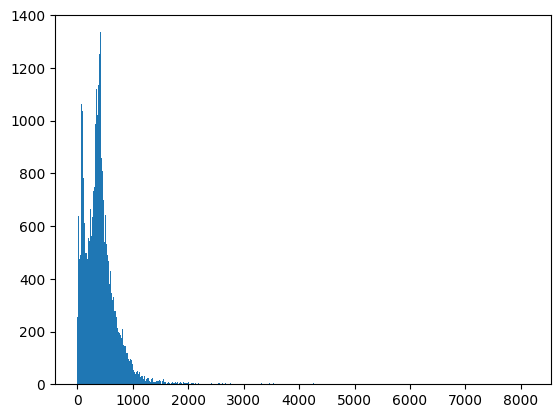

In [78]:
plt.hist([len(i) for i in x],bins=700)
plt.show()

In [79]:
#now we trying to truncate all the news which have length more than 1000 words

In [80]:
nos=np.array([len(i) for i in x])
len(nos[nos>1000])

1577

The pad_sequence function is a utility function typically used in natural language processing (NLP) tasks to pad sequences to a fixed length
here pad_sequence truncate all the text greatet than 1000 words and add '0' to the text with < 1000 words

In [82]:
maxlen=1000
x=pad_sequences(x,maxlen=maxlen)

In [83]:
len(x[0])

1000

In [ ]:
#actually the indexes start from 1 so we 

In [84]:
vocab_size=len(tokenizer.word_index)+1
vocab=tokenizer.word_index

In [90]:
def get_weight_matrix(model):
    weight_matrix=np.zeros((vocab_size,DIM))
    for word,i in vocab.items():
        weight_matrix[i]=model.wv[word]
    return weight_matrix

In [92]:
embedding_vectors=get_weight_matrix(w2v_model)

In [93]:
embedding_vectors.shape

(251802, 100)

In [95]:
model=Sequential()
model.add(Embedding(vocab_size,output_dim=DIM,weights=[embedding_vectors],input_length=maxlen,trainable=False))
model.add(LSTM(units=128))
model.add(Dense(1,activation='sigmoid'))
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['acc'])


In [96]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 1000, 100)         25180200  
                                                                 
 lstm (LSTM)                 (None, 128)               117248    
                                                                 
 dense (Dense)               (None, 1)                 129       
                                                                 
Total params: 25,297,577
Trainable params: 117,377
Non-trainable params: 25,180,200
_________________________________________________________________


In [97]:
x_train,x_test,y_train,y_test=train_test_split(x,y)

In [98]:
model.fit(x_train,y_train,validation_split=0.3,epochs=6)

Epoch 1/6
737/737 [==============================] - 1164s 2s/step - loss: 0.1396 - acc: 0.9472 - val_loss: 0.0904 - val_acc: 0.9666
Epoch 2/6
737/737 [==============================] - 1087s 1s/step - loss: 0.0484 - acc: 0.9838 - val_loss: 0.0446 - val_acc: 0.9854
Epoch 3/6
737/737 [==============================] - 1569s 2s/step - loss: 0.0259 - acc: 0.9919 - val_loss: 0.0308 - val_acc: 0.9909
Epoch 4/6
737/737 [==============================] - 927s 1s/step - loss: 0.0169 - acc: 0.9950 - val_loss: 0.0406 - val_acc: 0.9887
Epoch 5/6
737/737 [==============================] - 628s 853ms/step - loss: 0.0226 - acc: 0.9923 - val_loss: 0.0372 - val_acc: 0.9889
Epoch 6/6
737/737 [==============================] - 657s 891ms/step - loss: 0.0103 - acc: 0.9969 - val_loss: 0.0204 - val_acc: 0.9945


In [99]:
y_pred=(model.predict(x_test)>=0.5).astype(int)

351/351 [==============================] - 86s 243ms/step


In [100]:
accuracy_score(y_test, y_pred)

0.9942984409799555

In [101]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5904
           1       0.99      0.99      0.99      5321

    accuracy                           0.99     11225
   macro avg       0.99      0.99      0.99     11225
weighted avg       0.99      0.99      0.99     11225

